## Import and load

In [23]:
from ultralytics import YOLO
from pathlib import Path
from PIL import Image
import matplotlib.pyplot as plt

# Load a pretrained YOLOv8 (“yolov8n” is the small, fast model — good for many frames)
yolo_model = YOLO("yolov8n.pt")


## Load frame folder

In [16]:
# Adjust this to your frames folder
FRAMES_DIR = Path("output_frames")

# Load all frames
frame_paths = sorted(FRAMES_DIR.glob("*.jpg"))

print(f"Loaded {len(frame_paths)} frames.")


Loaded 155 frames.


## Detect function

In [17]:
def detect_objects(image_path, target_class=None):
    """
    Runs YOLO on an image.
    If target_class is provided, returns only detections matching the given label.
    """
    results = yolo_model(image_path)[0]
    detections = []

    for box in results.boxes:
        cls_id = int(box.cls[0])
        label = yolo_model.names[cls_id]

        # Filter if a target object is requested
        if target_class and label.lower() != target_class.lower():
            continue

        x1, y1, x2, y2 = box.xyxy[0].tolist()
        conf = float(box.conf[0])

        detections.append({
            "label": label,
            "confidence": conf,
            "bbox": (x1, y1, x2, y2)
        })

    return detections


## Search all frames for an object

In [18]:
def search_frames_for_object(query, image_paths):
    """
    Returns a dictionary: {image_path → list of detections}
    Only images where the object was found are returned.
    """
    print(f"Searching for: {query}")
    results = {}

    for path in image_paths:
        dets = detect_objects(path, target_class=query)
        if dets:
            results[path] = dets

    return results


## Display frames with bounding boxes

In [19]:
def show_yolo_results(results):
    """
    Displays detected frames with bounding boxes drawn.
    results = dict: {Path → [detections]}
    """
    for path, dets in results.items():
        print(f"\n{path.name} — {len(dets)} detections")

        img = Image.open(path)
        plt.figure(figsize=(6,6))
        plt.imshow(img)
        ax = plt.gca()

        for det in dets:
            x1, y1, x2, y2 = det["bbox"]
            label = det["label"]
            conf = det["confidence"]

            # Draw the rectangle
            rect = plt.Rectangle(
                (x1, y1), x2 - x1, y2 - y1,
                fill=False, edgecolor="red", linewidth=2
            )
            ax.add_patch(rect)

            # Add label text
            ax.text(
                x1, y1 - 5,
                f"{label} ({conf:.2f})",
                fontsize=10, color="yellow",
                bbox=dict(facecolor="black", alpha=0.5)
            )

        plt.axis("off")
        plt.show()


In [21]:
from pathlib import Path

FRAMES_DIR = Path("output_frames")
image_paths = sorted(FRAMES_DIR.glob("*.jpg"))

print(f"Loaded {len(image_paths)} frames")

Loaded 155 frames


## Run search query

Searching for: person

image 1/1 /Users/Cecilia/Documents/Programación/archive_filter/output_frames/frame_00000.jpg: 640x384 4 persons, 41.4ms
Speed: 2.4ms preprocess, 41.4ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 384)

image 1/1 /Users/Cecilia/Documents/Programación/archive_filter/output_frames/frame_00001.jpg: 640x384 2 persons, 29.4ms
Speed: 1.0ms preprocess, 29.4ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 384)

image 1/1 /Users/Cecilia/Documents/Programación/archive_filter/output_frames/frame_00002.jpg: 640x384 3 persons, 1 traffic light, 29.6ms
Speed: 0.9ms preprocess, 29.6ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 384)

image 1/1 /Users/Cecilia/Documents/Programación/archive_filter/output_frames/frame_00003.jpg: 640x384 3 cars, 28.3ms
Speed: 0.9ms preprocess, 28.3ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 384)

image 1/1 /Users/Cecilia/Documents/Programación/archive_filter/output_frames/frame_000

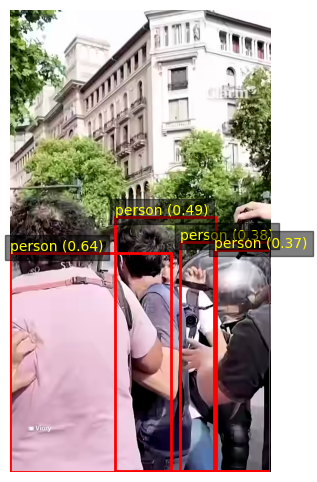


frame_00001.jpg — 2 detections


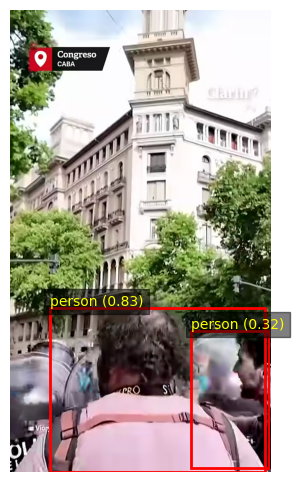


frame_00002.jpg — 3 detections


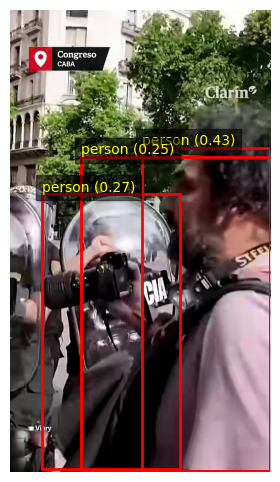


frame_00004.jpg — 3 detections


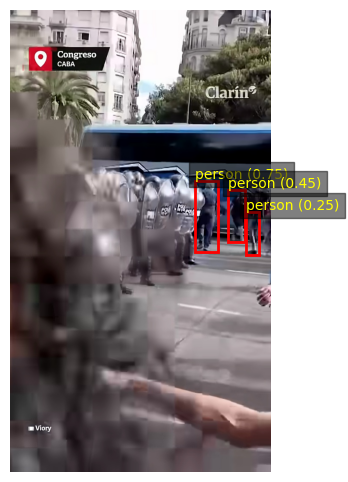


frame_00005.jpg — 6 detections


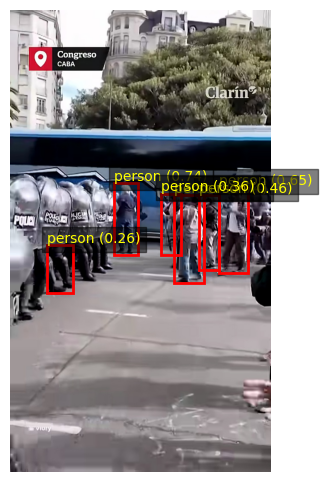


frame_00006.jpg — 6 detections


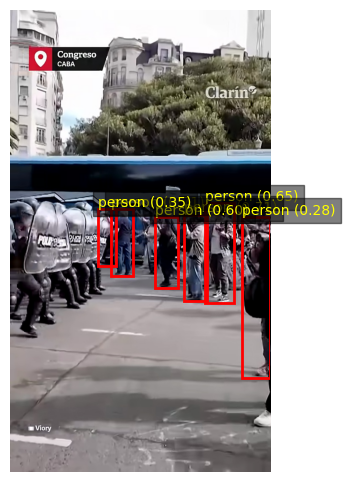


frame_00007.jpg — 4 detections


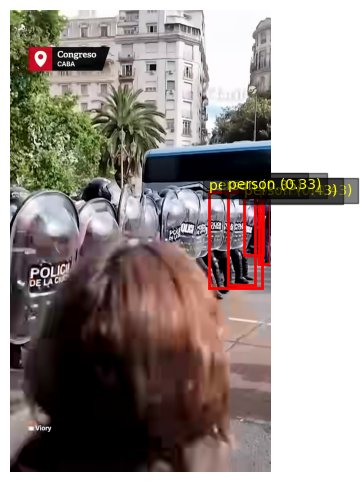


frame_00008.jpg — 2 detections


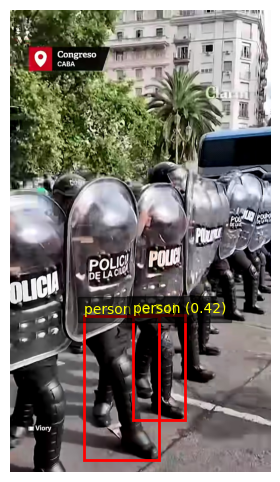


frame_00009.jpg — 4 detections


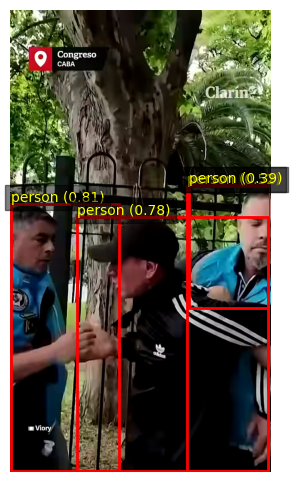


frame_00010.jpg — 2 detections


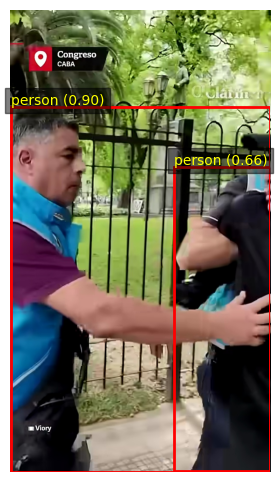


frame_00011.jpg — 2 detections


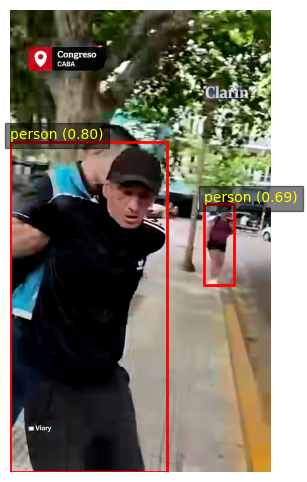


frame_00012.jpg — 6 detections


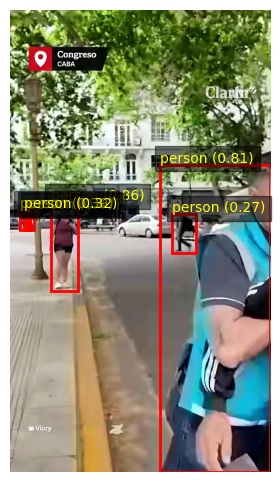


frame_00013.jpg — 3 detections


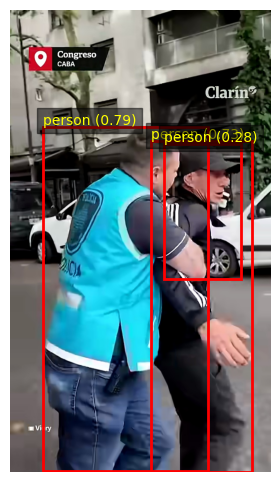


frame_00014.jpg — 12 detections


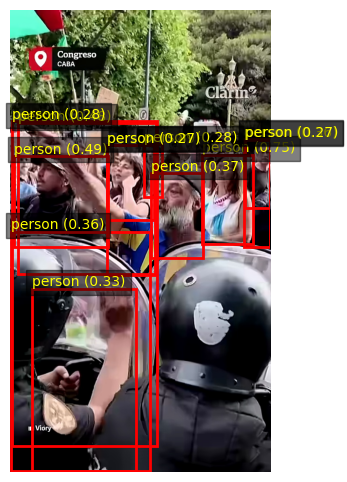


frame_00015.jpg — 3 detections


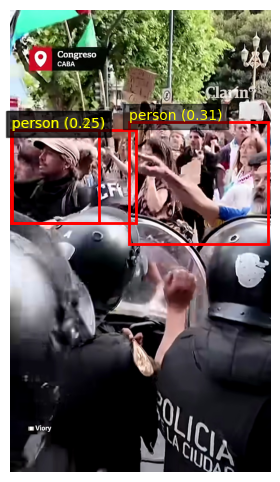


frame_00016.jpg — 5 detections


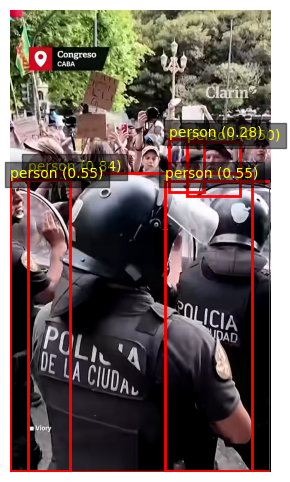


frame_00017.jpg — 6 detections


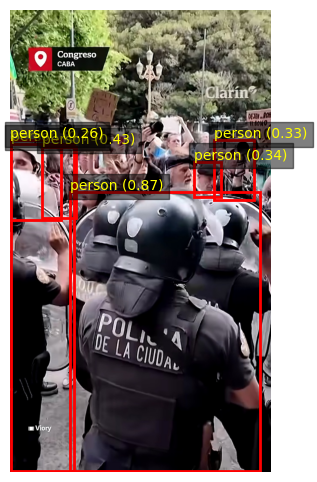


frame_00018.jpg — 6 detections


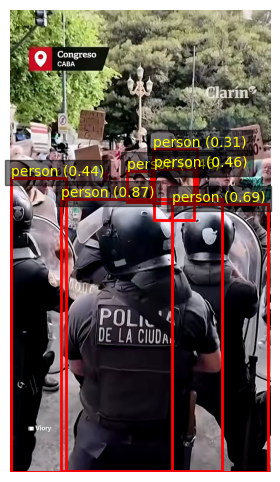


frame_00019.jpg — 9 detections


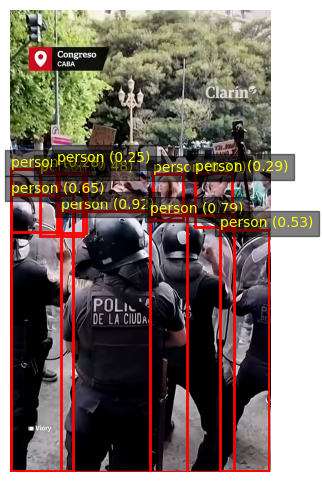


frame_00020.jpg — 5 detections


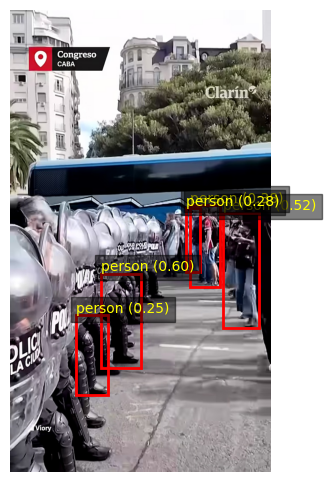


frame_00021.jpg — 7 detections


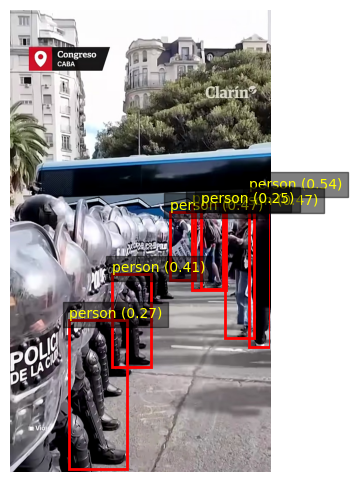


frame_00022.jpg — 8 detections


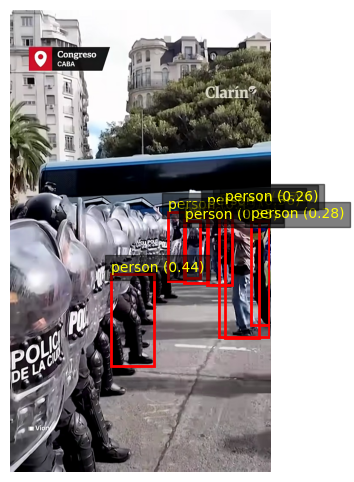


frame_00023.jpg — 9 detections


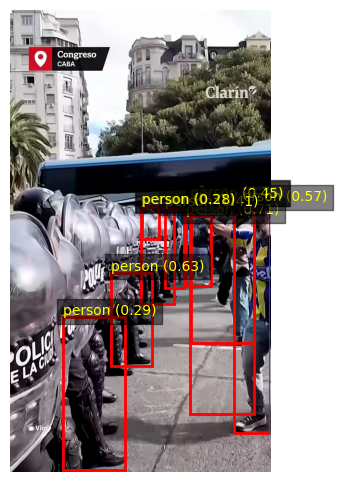


frame_00024.jpg — 6 detections


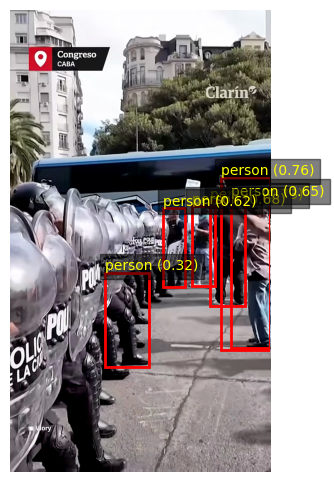


frame_00025.jpg — 7 detections


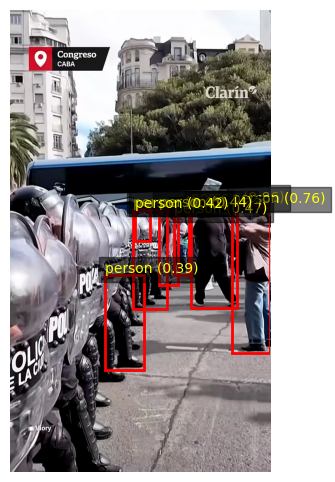


frame_00026.jpg — 7 detections


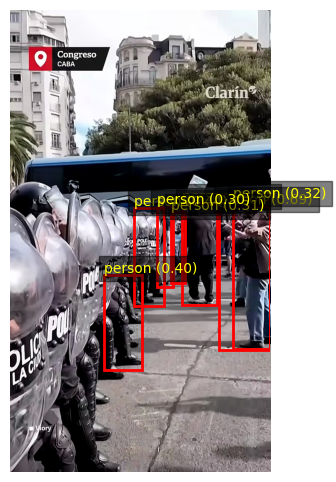


frame_00027.jpg — 7 detections


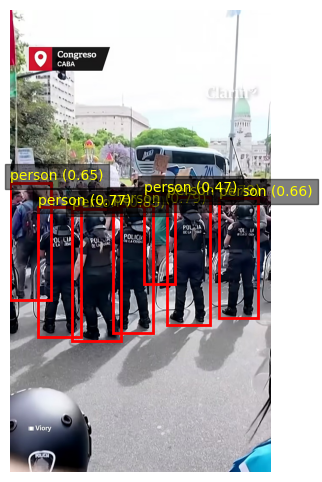


frame_00028.jpg — 9 detections


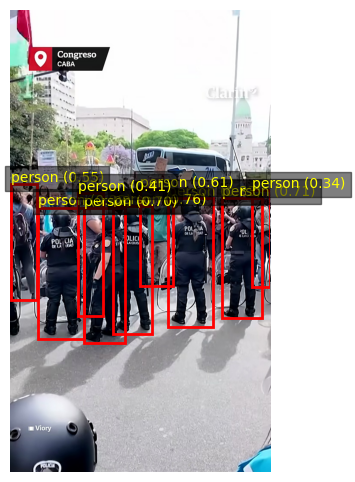


frame_00029.jpg — 7 detections


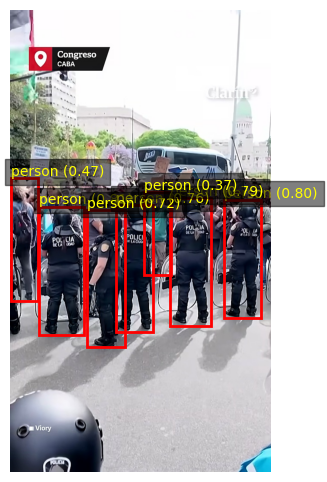


frame_00030.jpg — 7 detections


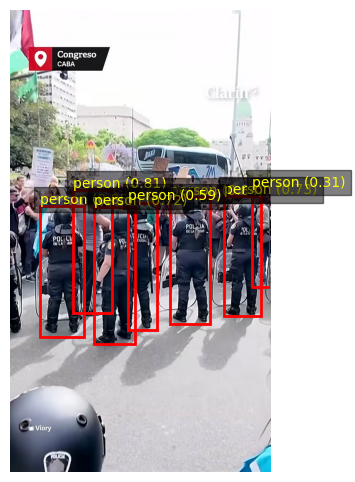


frame_00031.jpg — 5 detections


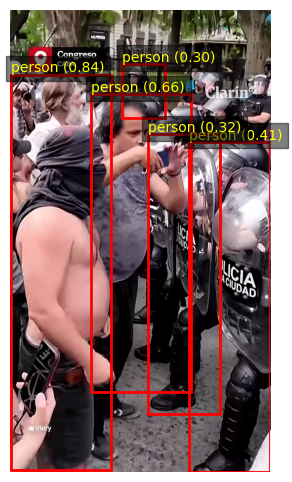


frame_00032.jpg — 7 detections


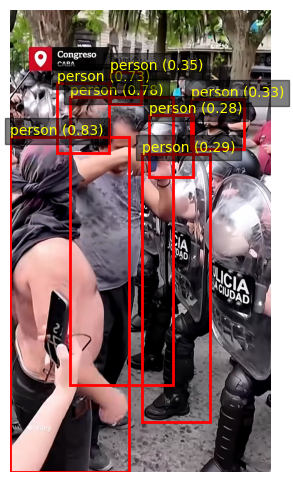


frame_00033.jpg — 6 detections


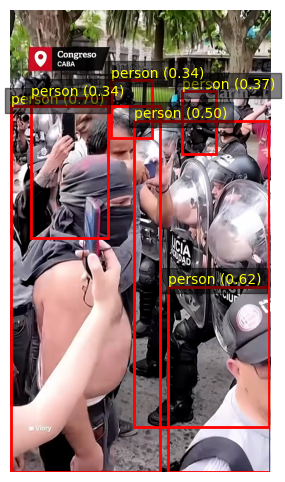


frame_00034.jpg — 12 detections


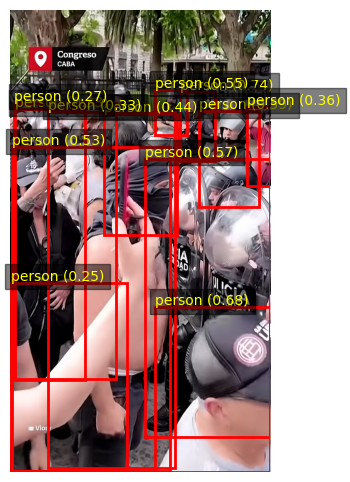


frame_00035.jpg — 8 detections


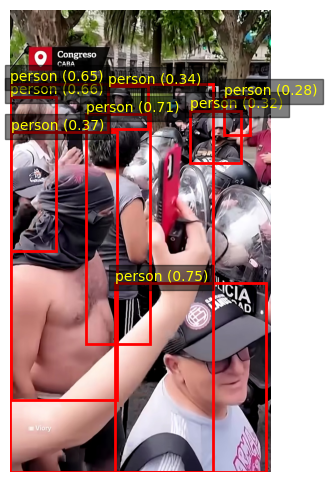


frame_00036.jpg — 2 detections


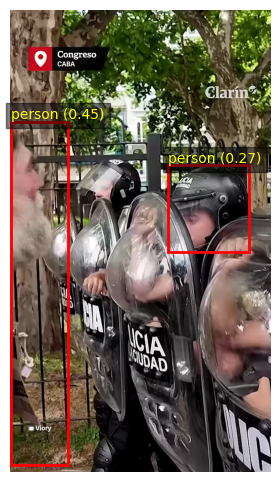


frame_00037.jpg — 8 detections


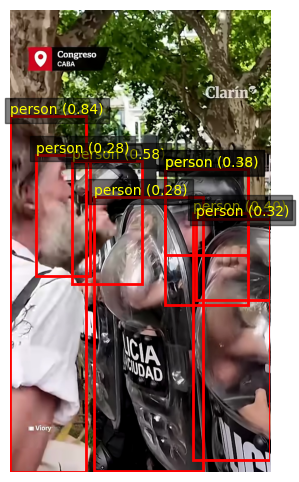


frame_00038.jpg — 5 detections


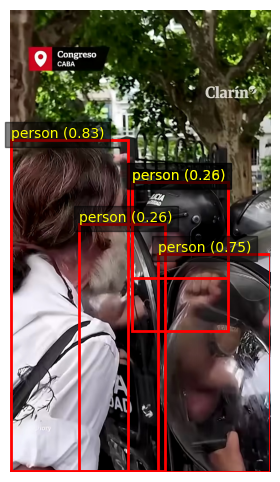


frame_00039.jpg — 3 detections


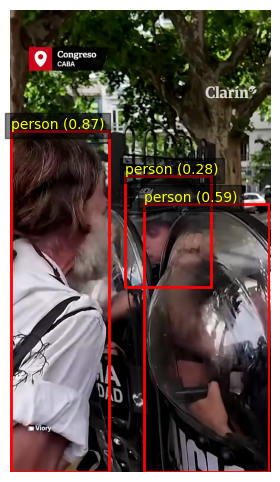


frame_00040.jpg — 9 detections


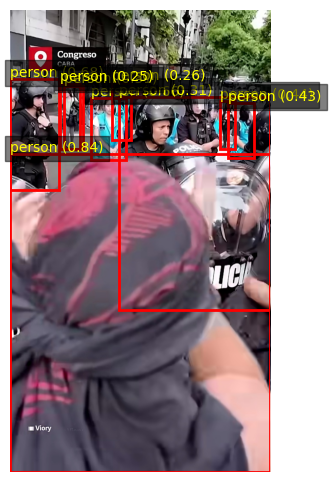


frame_00041.jpg — 11 detections


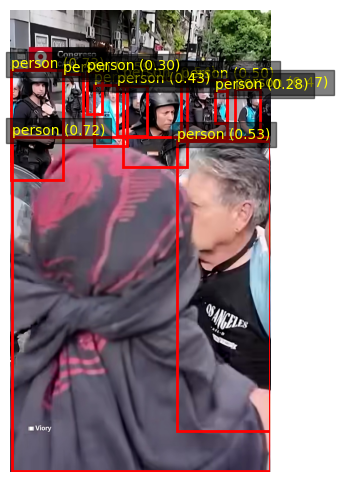


frame_00042.jpg — 12 detections


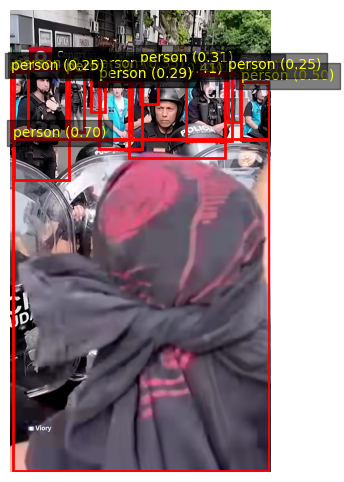


frame_00043.jpg — 9 detections


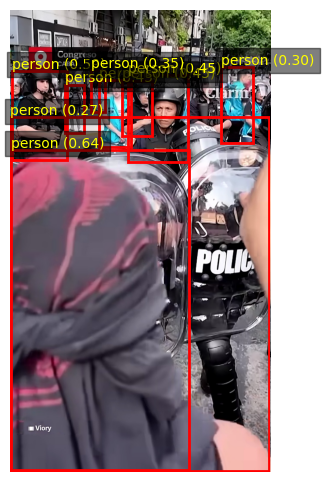


frame_00044.jpg — 5 detections


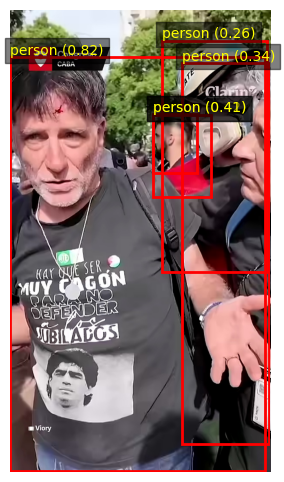


frame_00045.jpg — 5 detections


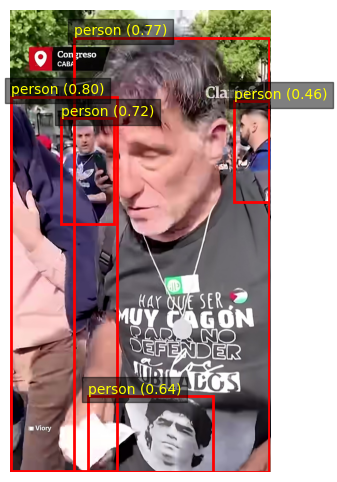


frame_00046.jpg — 4 detections


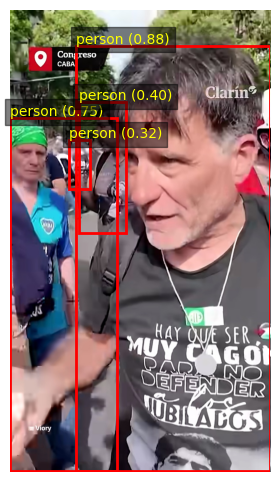


frame_00047.jpg — 5 detections


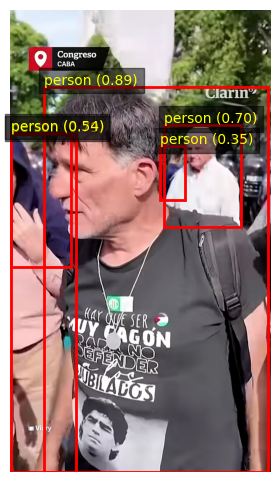


frame_00048.jpg — 2 detections


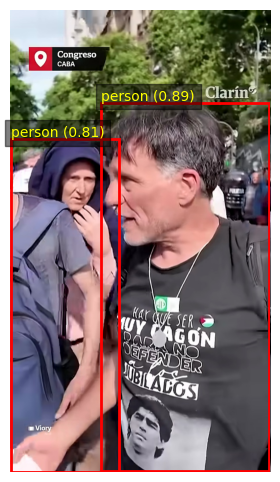


frame_00049.jpg — 2 detections


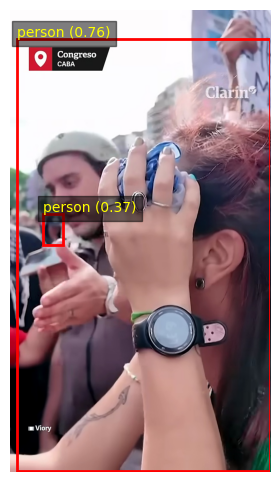


frame_00050.jpg — 5 detections


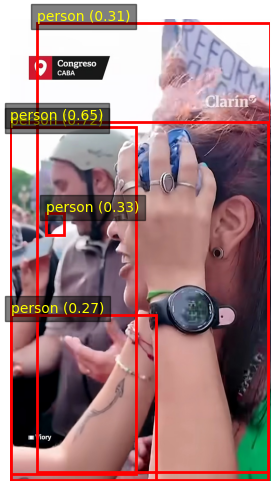


frame_00051.jpg — 6 detections


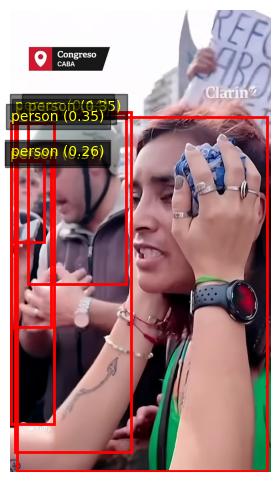


frame_00052.jpg — 7 detections


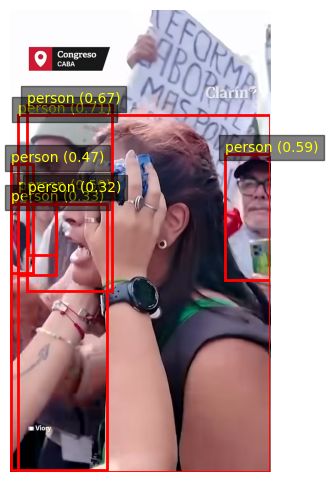


frame_00053.jpg — 5 detections


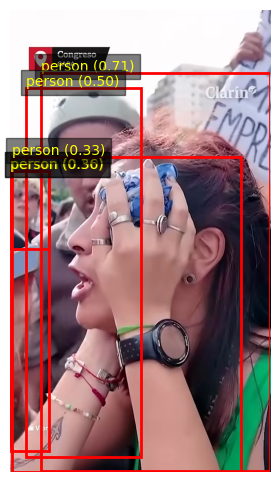


frame_00054.jpg — 3 detections


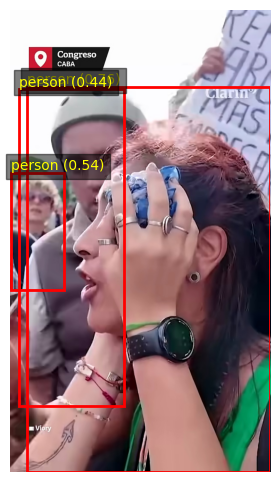


frame_00055.jpg — 1 detections


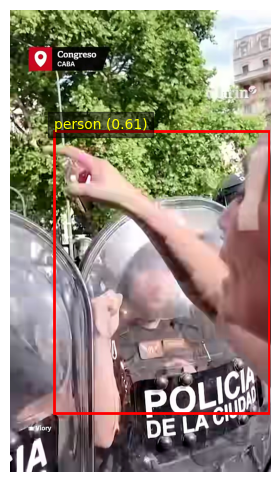


frame_00056.jpg — 2 detections


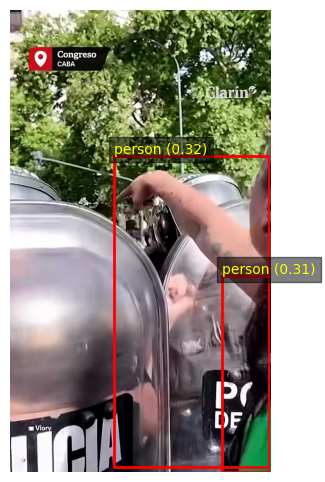


frame_00058.jpg — 1 detections


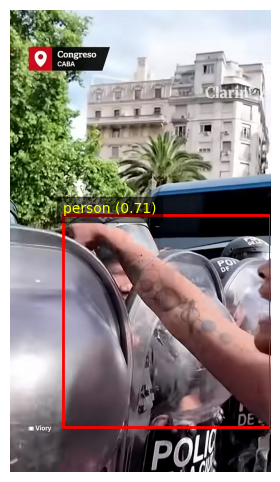


frame_00059.jpg — 9 detections


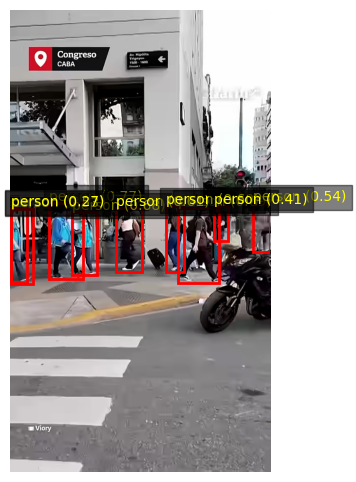


frame_00060.jpg — 9 detections


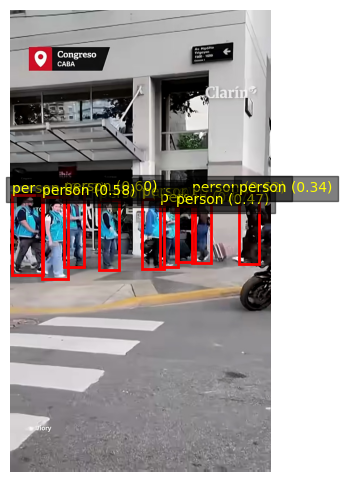


frame_00061.jpg — 14 detections


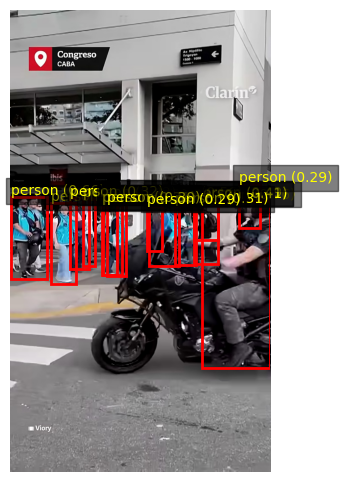


frame_00062.jpg — 13 detections


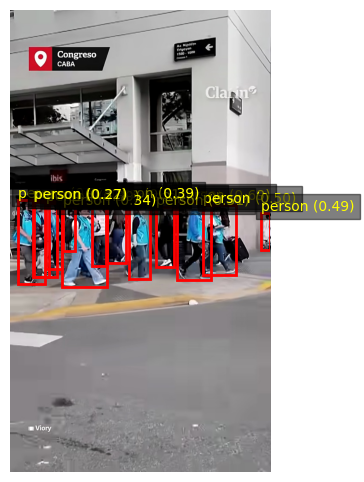


frame_00063.jpg — 10 detections


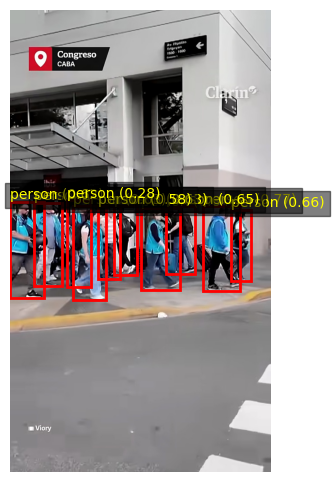


frame_00064.jpg — 3 detections


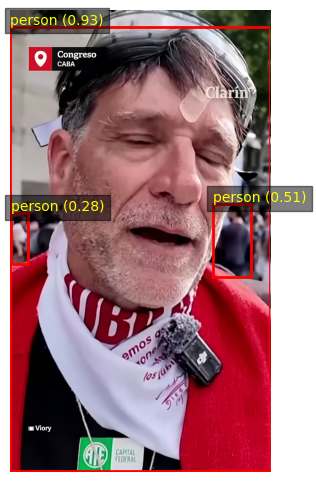


frame_00065.jpg — 3 detections


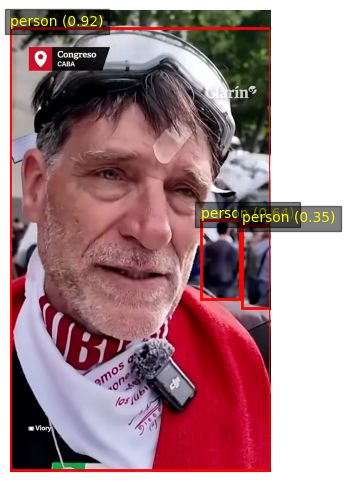


frame_00066.jpg — 2 detections


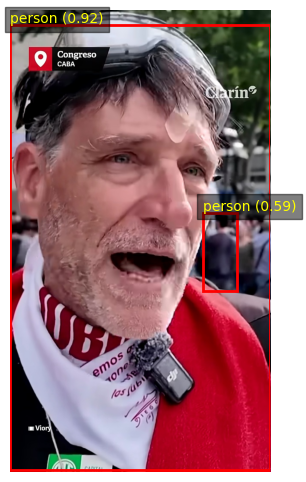


frame_00067.jpg — 6 detections


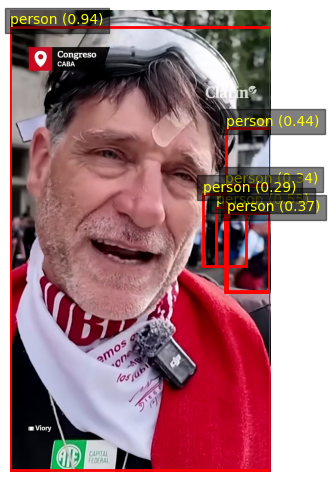


frame_00068.jpg — 3 detections


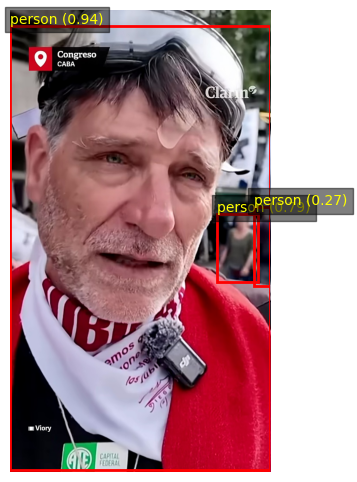


frame_00069.jpg — 2 detections


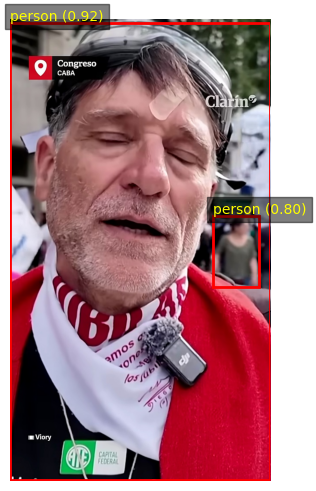


frame_00070.jpg — 4 detections


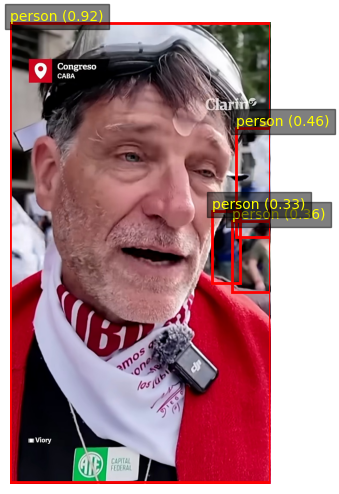


frame_00071.jpg — 2 detections


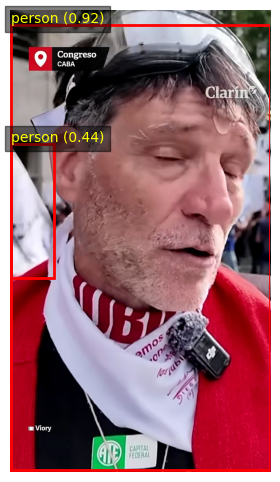


frame_00072.jpg — 3 detections


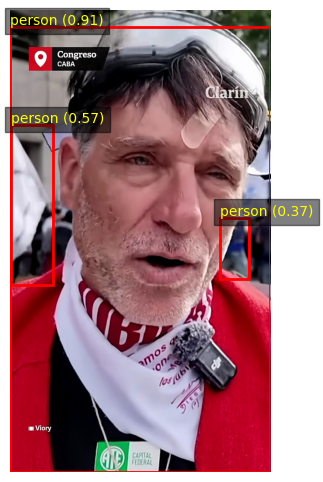


frame_00073.jpg — 4 detections


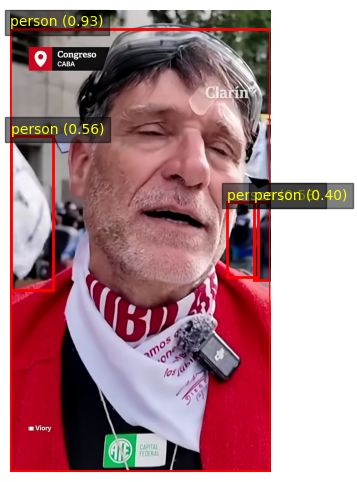


frame_00074.jpg — 5 detections


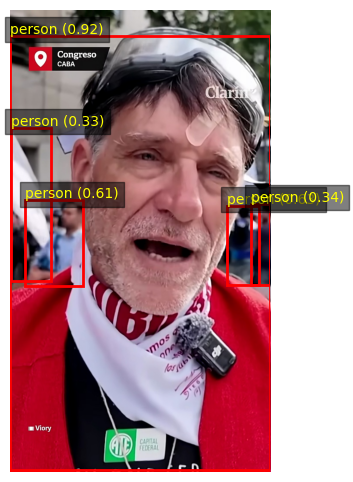


frame_00075.jpg — 5 detections


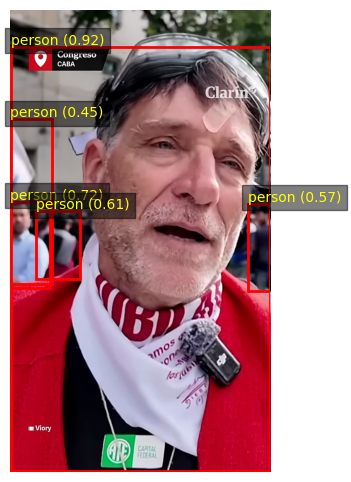


frame_00076.jpg — 4 detections


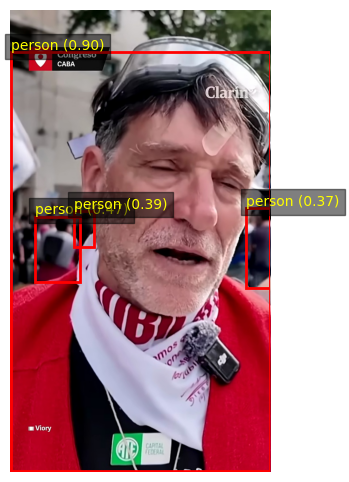


frame_00077.jpg — 3 detections


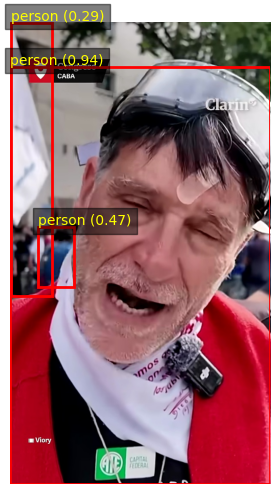


frame_00078.jpg — 3 detections


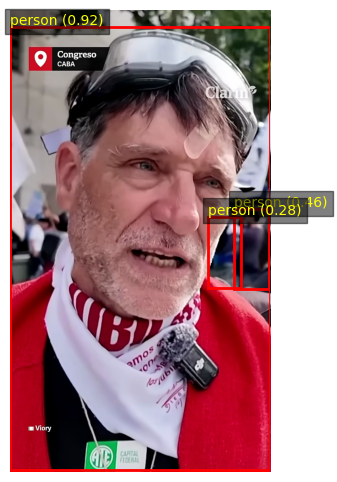


frame_00079.jpg — 5 detections


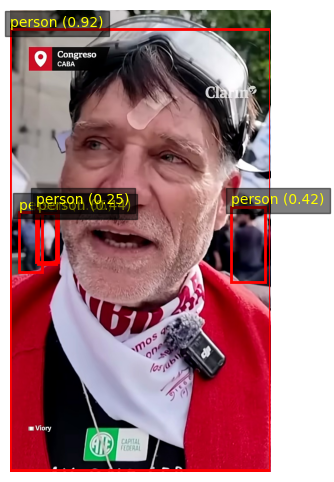


frame_00080.jpg — 4 detections


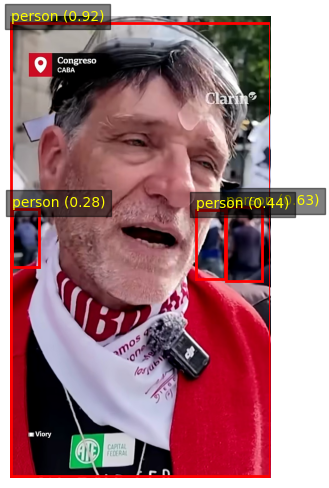


frame_00081.jpg — 2 detections


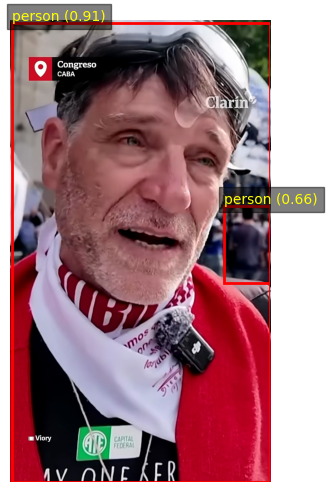


frame_00082.jpg — 2 detections


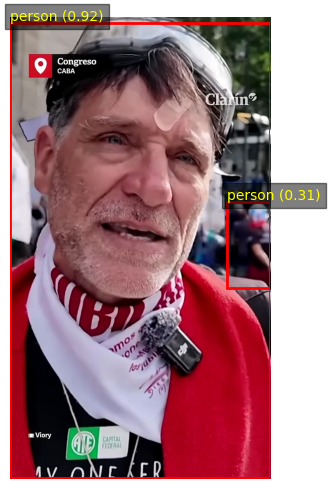


frame_00083.jpg — 3 detections


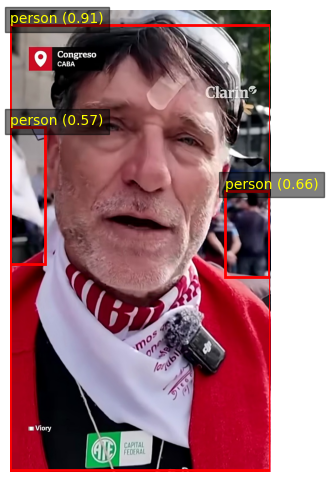


frame_00084.jpg — 3 detections


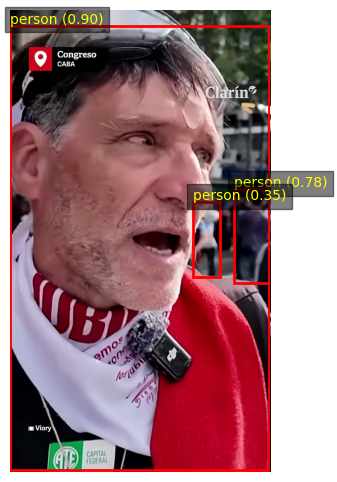


frame_00085.jpg — 3 detections


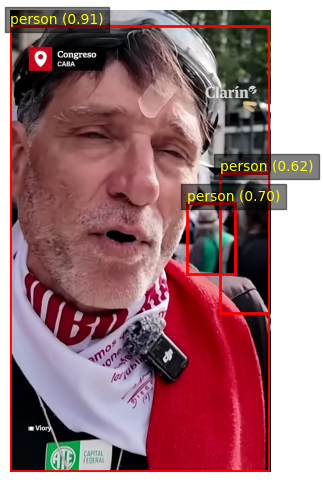


frame_00086.jpg — 3 detections


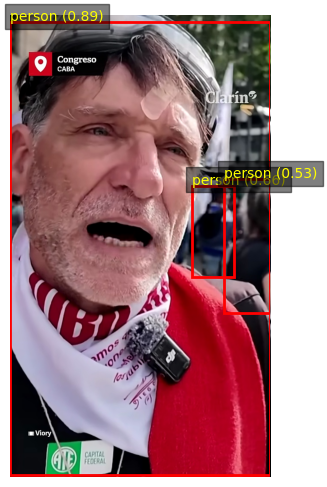


frame_00087.jpg — 3 detections


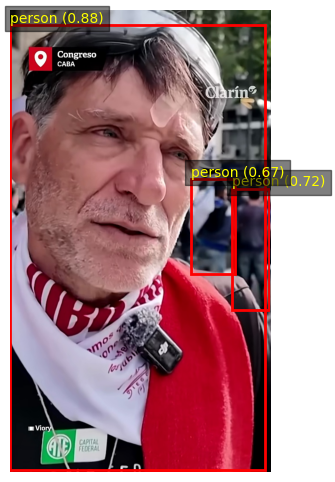


frame_00088.jpg — 3 detections


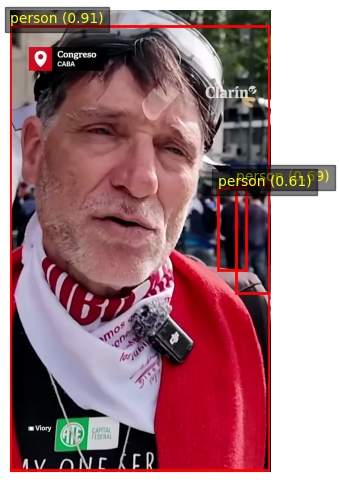


frame_00089.jpg — 3 detections


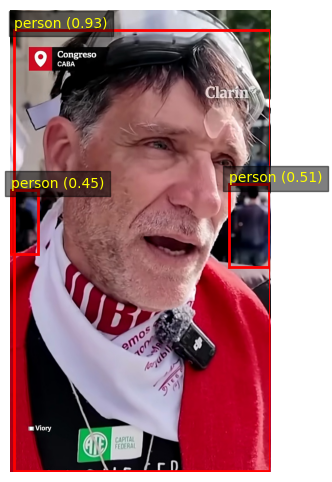


frame_00090.jpg — 3 detections


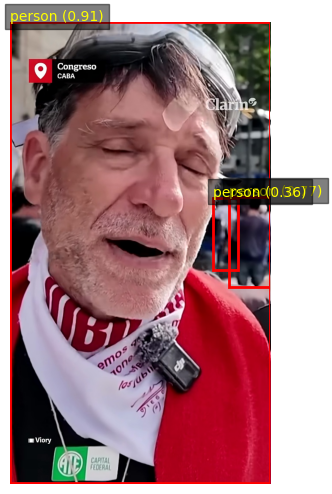


frame_00091.jpg — 3 detections


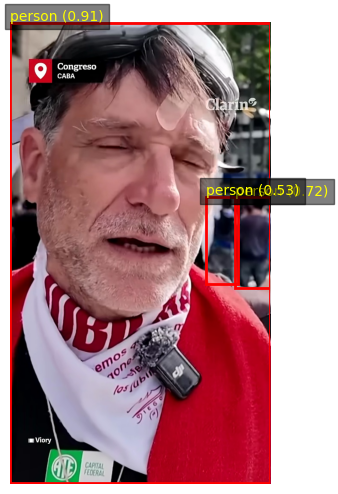


frame_00092.jpg — 2 detections


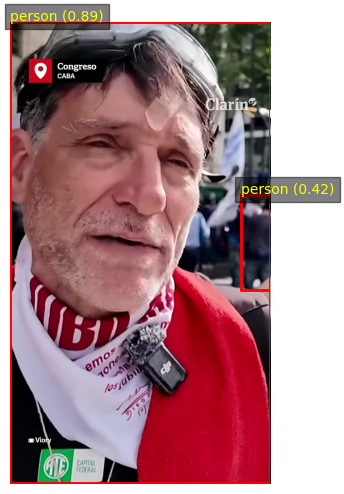


frame_00093.jpg — 3 detections


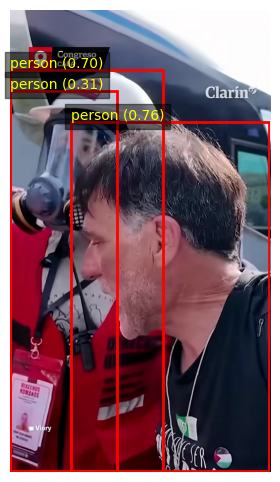


frame_00094.jpg — 1 detections


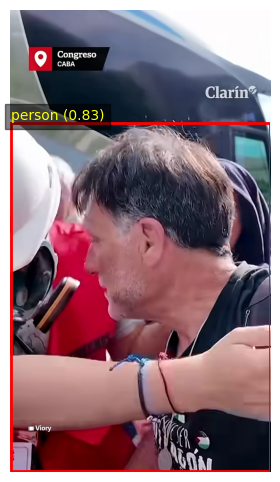


frame_00095.jpg — 6 detections


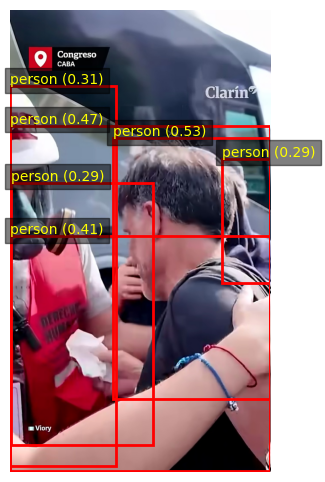


frame_00096.jpg — 4 detections


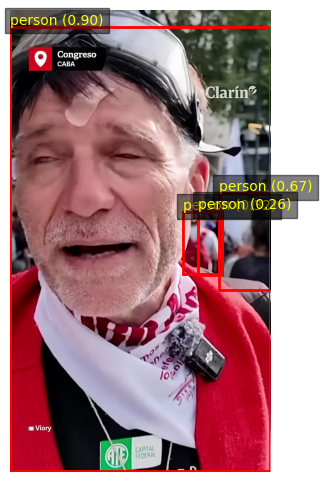


frame_00097.jpg — 4 detections


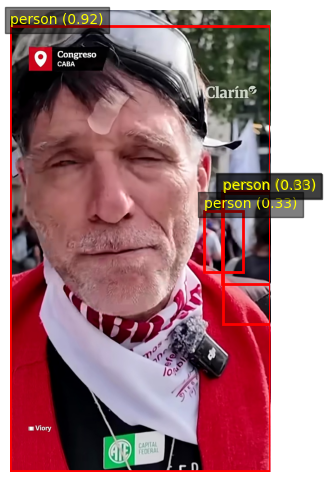


frame_00098.jpg — 3 detections


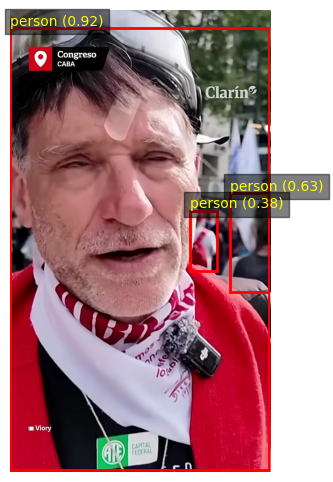


frame_00099.jpg — 2 detections


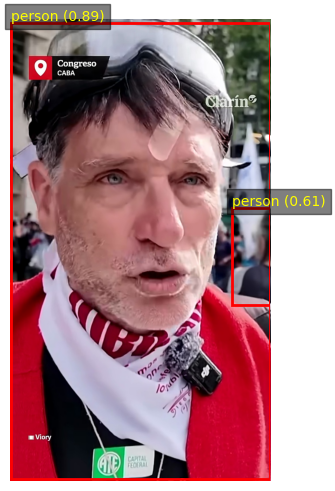


frame_00100.jpg — 2 detections


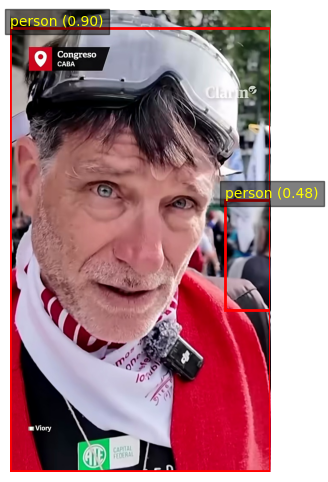


frame_00101.jpg — 4 detections


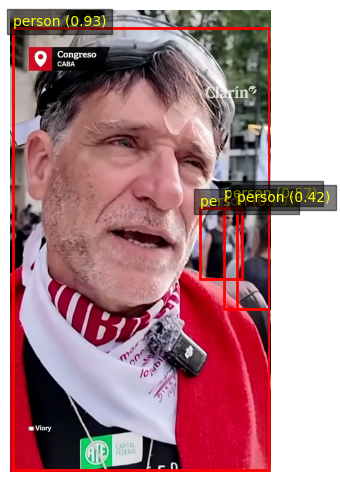


frame_00102.jpg — 2 detections


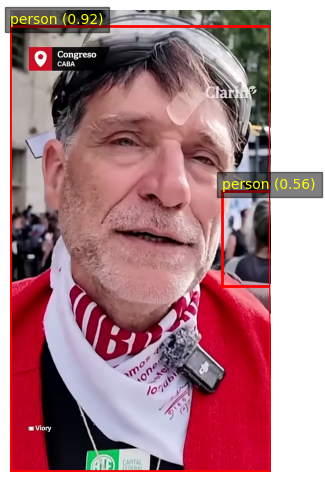


frame_00103.jpg — 3 detections


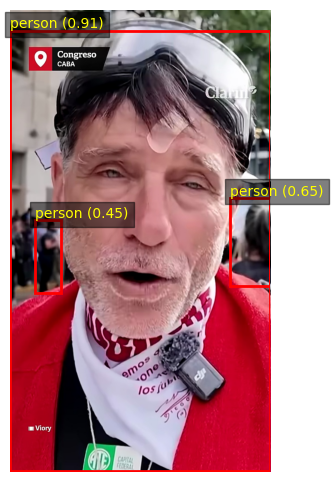


frame_00104.jpg — 9 detections


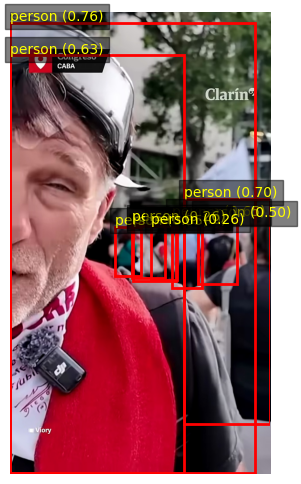


frame_00105.jpg — 3 detections


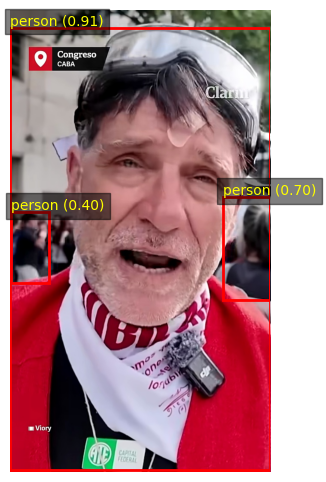


frame_00106.jpg — 3 detections


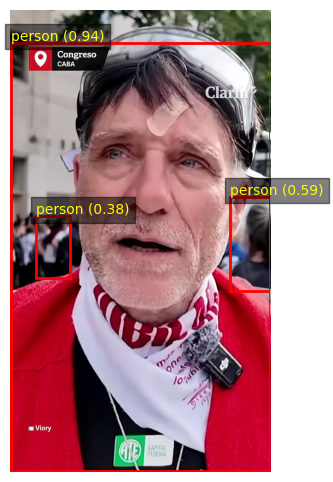


frame_00107.jpg — 5 detections


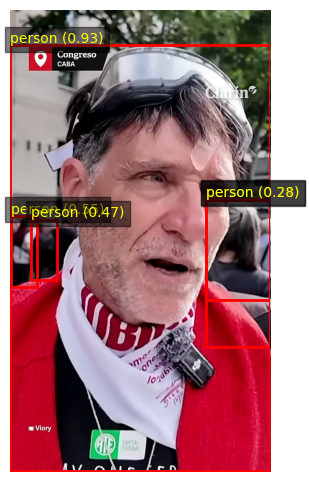


frame_00108.jpg — 4 detections


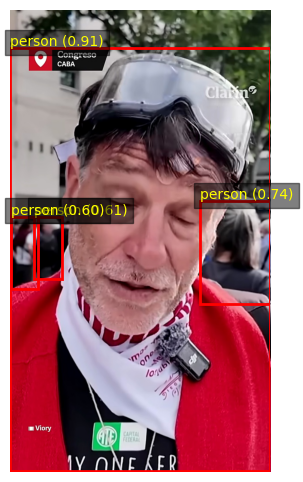


frame_00109.jpg — 5 detections


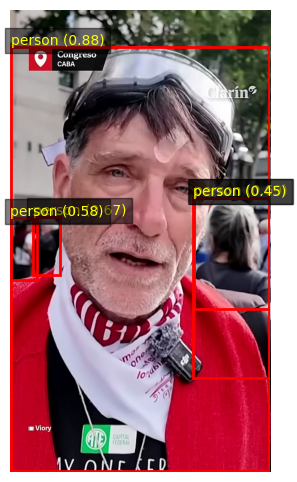


frame_00110.jpg — 5 detections


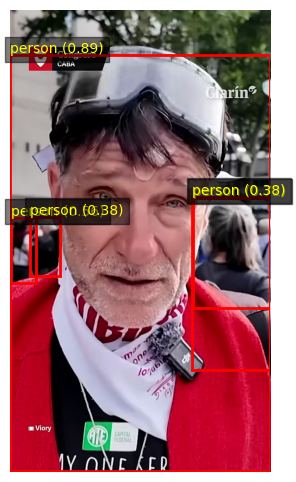


frame_00111.jpg — 4 detections


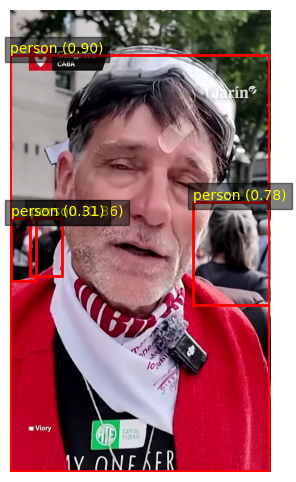


frame_00112.jpg — 7 detections


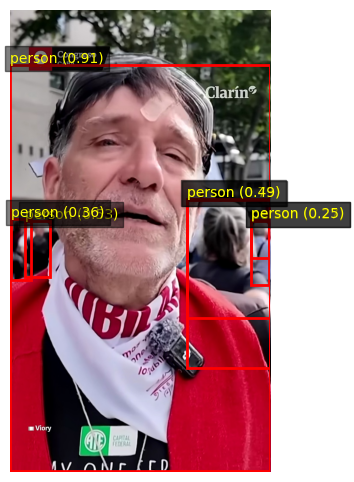


frame_00113.jpg — 7 detections


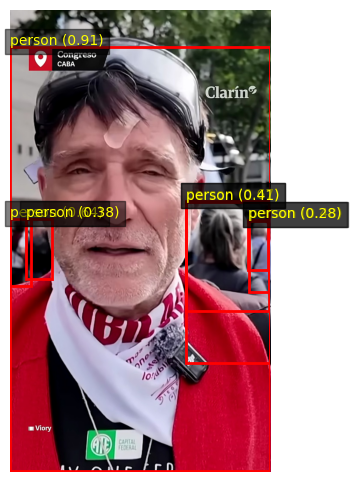


frame_00114.jpg — 4 detections


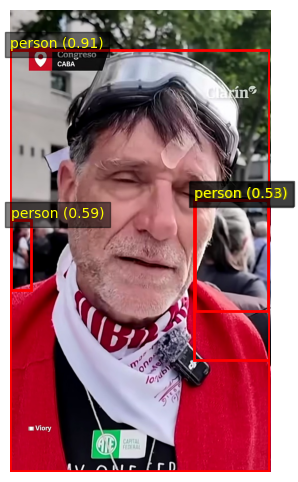


frame_00115.jpg — 7 detections


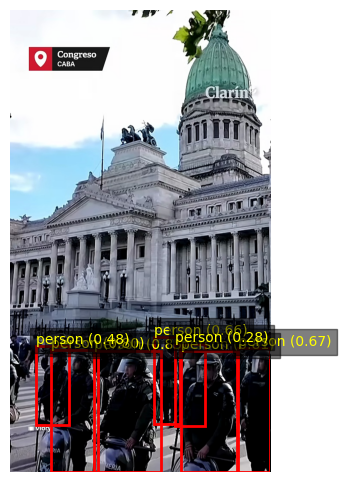


frame_00116.jpg — 9 detections


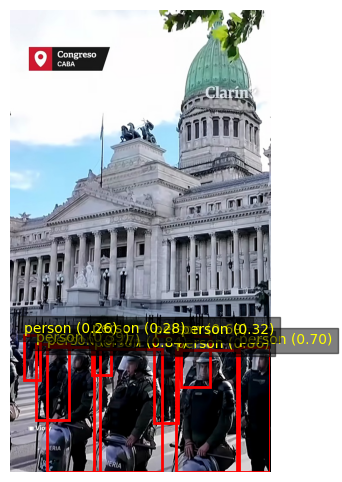


frame_00117.jpg — 10 detections


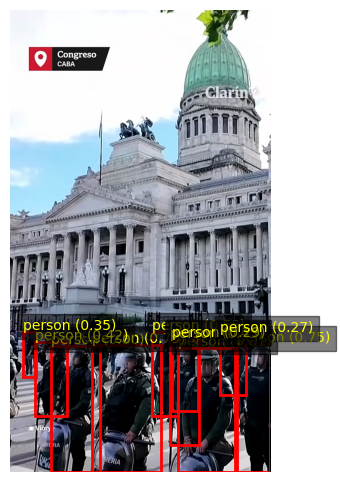


frame_00118.jpg — 9 detections


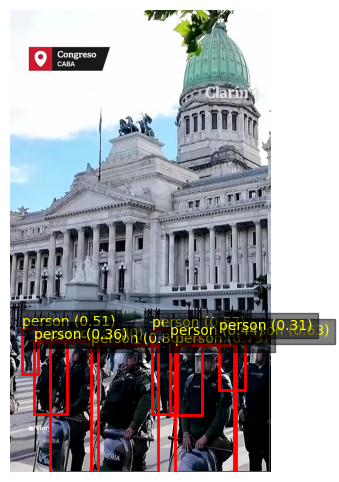


frame_00119.jpg — 9 detections


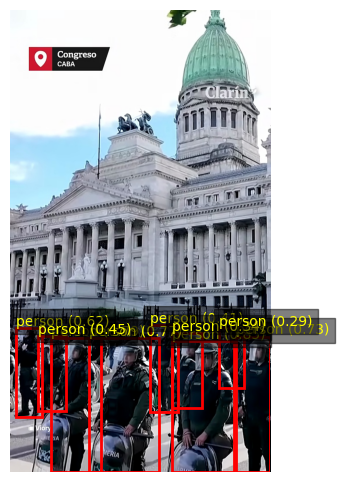


frame_00120.jpg — 3 detections


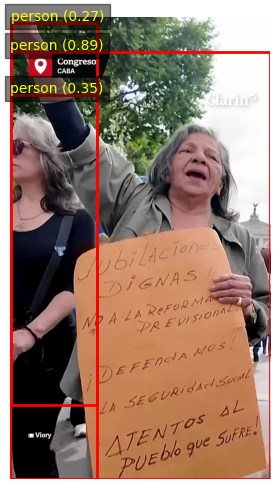


frame_00121.jpg — 2 detections


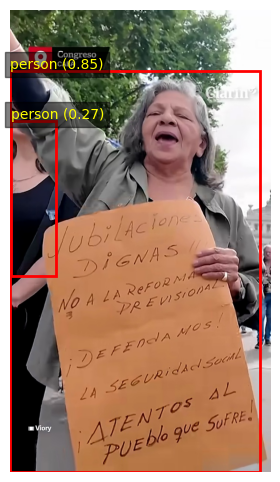


frame_00122.jpg — 2 detections


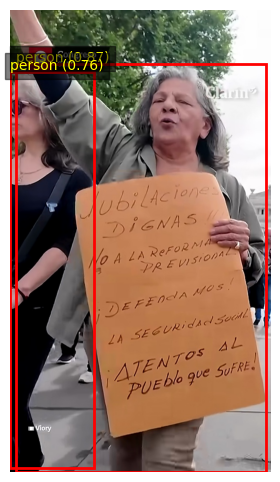


frame_00123.jpg — 3 detections


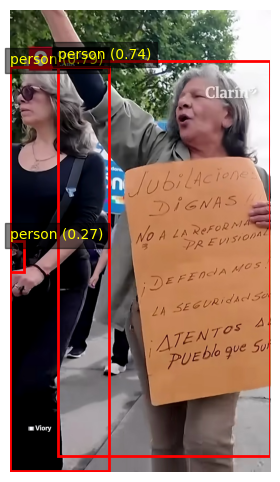


frame_00124.jpg — 7 detections


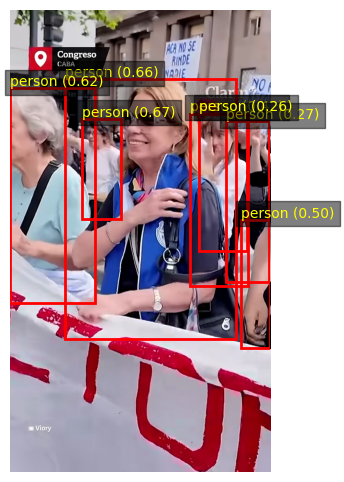


frame_00125.jpg — 7 detections


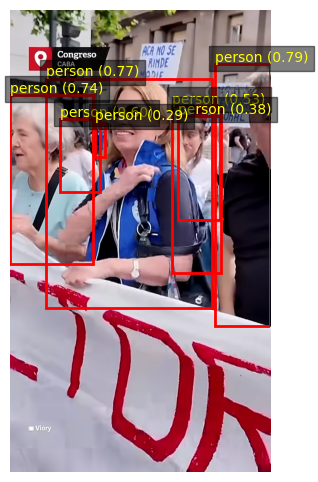


frame_00126.jpg — 7 detections


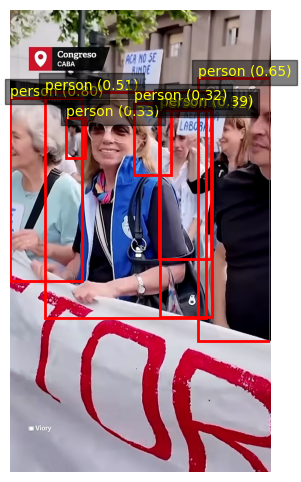


frame_00127.jpg — 5 detections


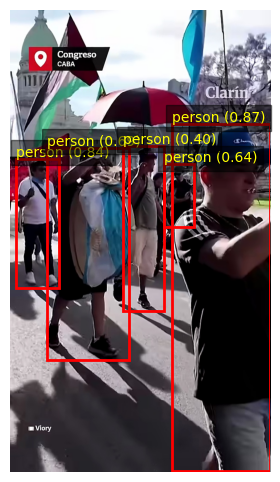


frame_00128.jpg — 6 detections


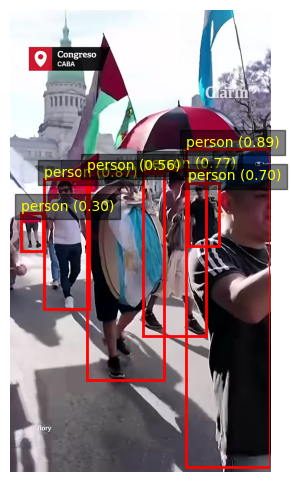


frame_00129.jpg — 4 detections


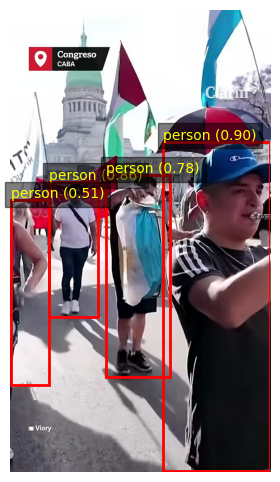


frame_00130.jpg — 5 detections


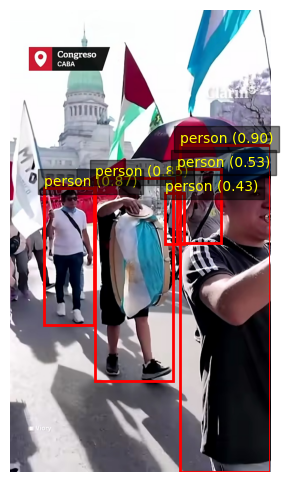


frame_00131.jpg — 7 detections


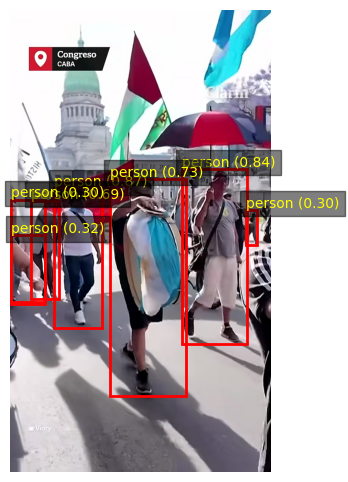


frame_00132.jpg — 7 detections


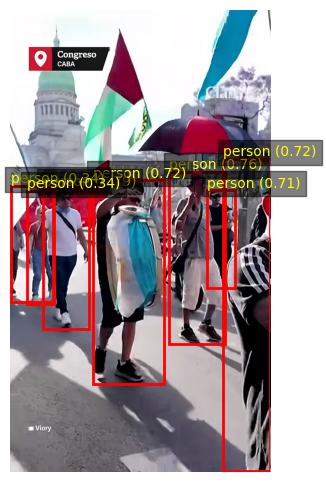


frame_00133.jpg — 5 detections


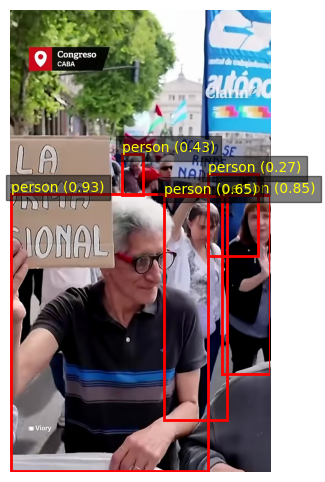


frame_00134.jpg — 8 detections


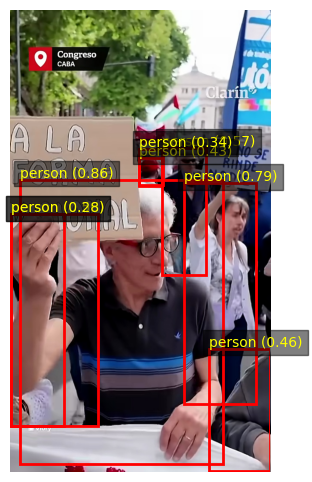


frame_00135.jpg — 6 detections


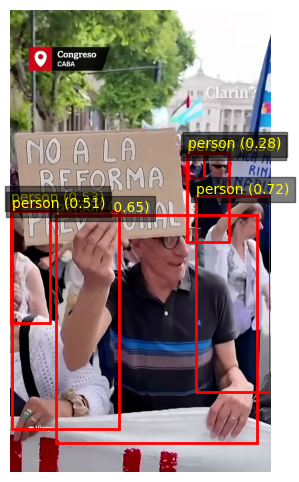


frame_00136.jpg — 5 detections


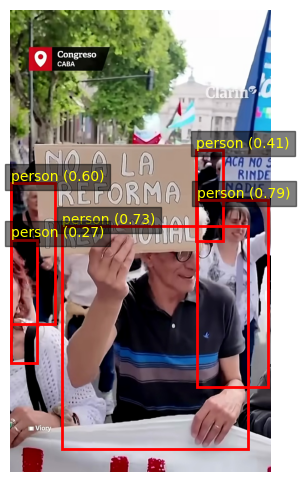


frame_00137.jpg — 8 detections


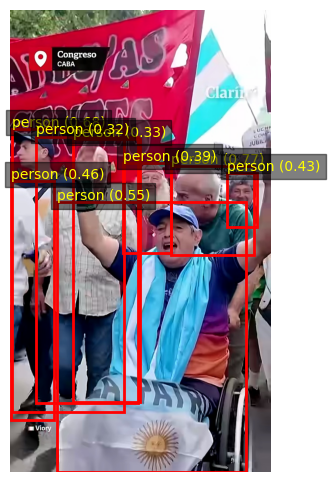


frame_00138.jpg — 8 detections


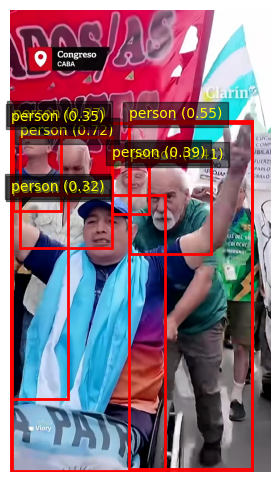


frame_00139.jpg — 4 detections


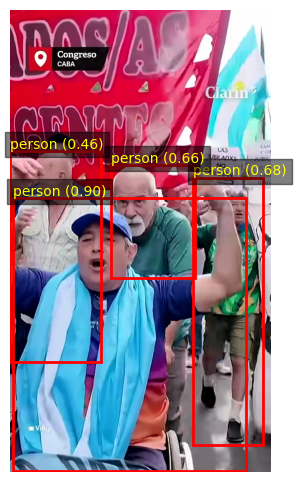


frame_00140.jpg — 5 detections


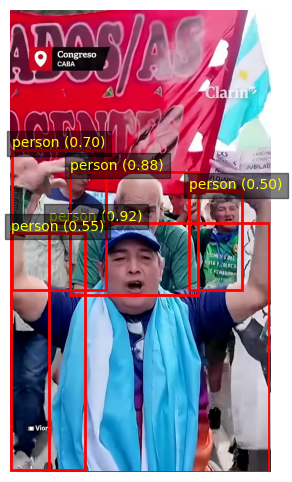


frame_00141.jpg — 6 detections


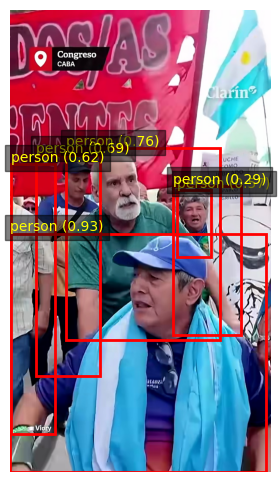


frame_00142.jpg — 4 detections


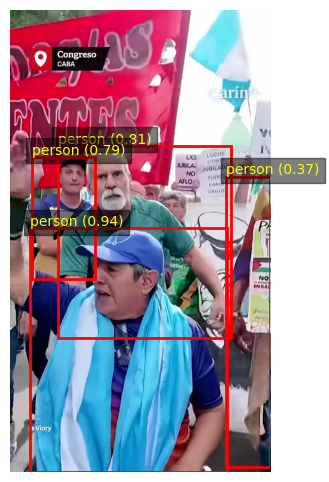


frame_00143.jpg — 6 detections


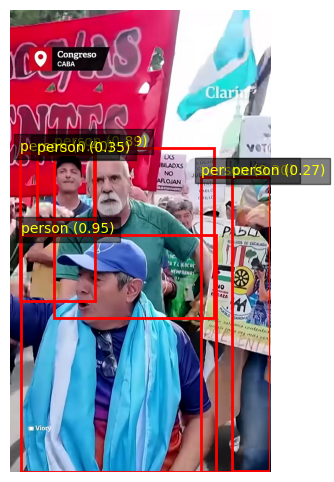


frame_00144.jpg — 7 detections


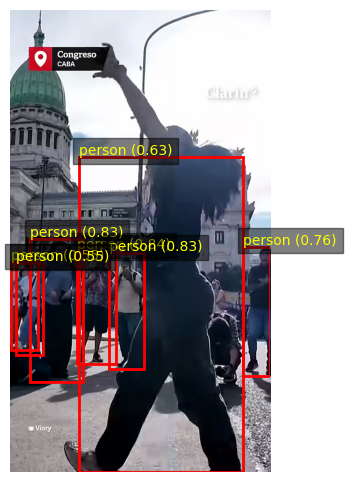


frame_00145.jpg — 8 detections


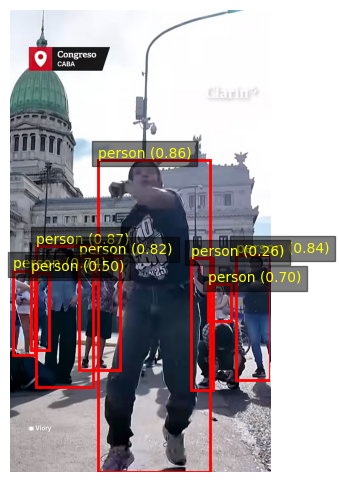


frame_00146.jpg — 9 detections


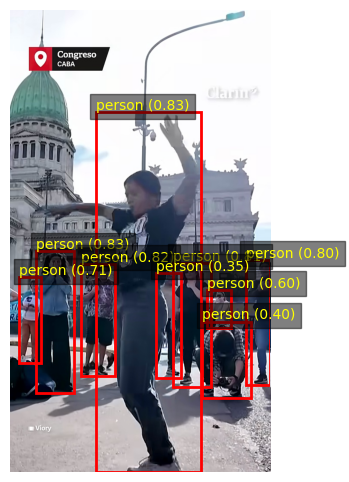


frame_00147.jpg — 8 detections


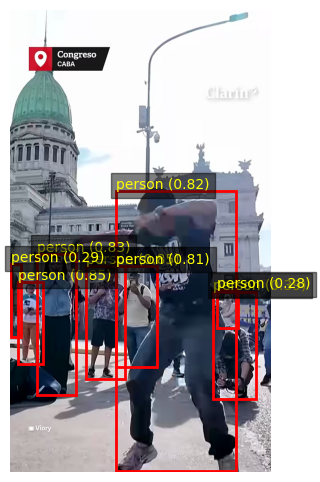


frame_00148.jpg — 7 detections


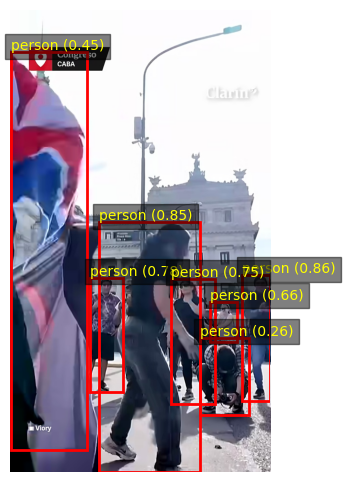


frame_00150.jpg — 4 detections


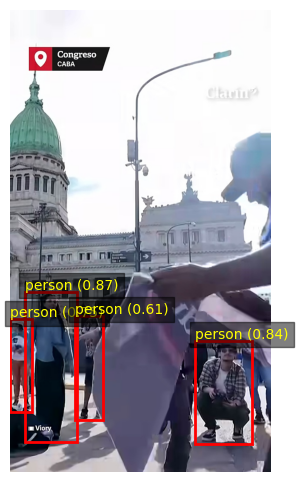


frame_00152.jpg — 2 detections


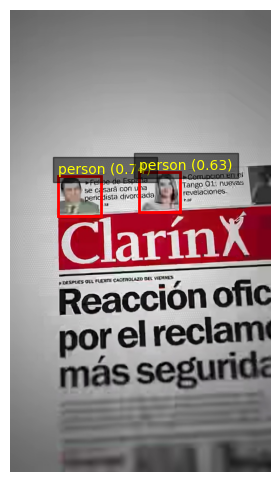

In [30]:
query = "person"    
results = search_frames_for_object(query, image_paths)
show_yolo_results(results)

# YOLOv8 COCO Object Classes (80 total)
# ------------------------------------
# 0: person
# 1: bicycle
# 2: car
# 3: motorcycle
# 4: airplane
# 5: bus
# 6: train
# 7: truck
# 8: boat
# 9: traffic light
# 10: fire hydrant
# 11: stop sign
# 12: parking meter
# 13: bench
# 14: bird
# 15: cat
# 16: dog
# 17: horse
# 18: sheep
# 19: cow
# 20: elephant
# 21: bear
# 22: zebra
# 23: giraffe
# 24: backpack
# 25: umbrella
# 26: handbag
# 27: tie
# 28: suitcase
# 29: frisbee
# 30: skis
# 31: snowboard
# 32: sports ball
# 33: kite
# 34: baseball bat
# 35: baseball glove
# 36: skateboard
# 37: surfboard
# 38: tennis racket
# 39: bottle
# 40: wine glass
# 41: cup
# 42: fork
# 43: knife
# 44: spoon
# 45: bowl
# 46: banana
# 47: apple
# 48: sandwich
# 49: orange
# 50: broccoli
# 51: carrot
# 52: hot dog
# 53: pizza
# 54: donut
# 55: cake
# 56: chair
# 57: couch
# 58: potted plant
# 59: bed
# 60: dining table
# 61: toilet
# 62: tv
# 63: laptop
# 64: mouse
# 65: remote
# 66: keyboard
# 67: cell phone
# 68: microwave
# 69: oven
# 70: toaster
# 71: sink
# 72: refrigerator
# 73: book
# 74: clock
# 75: vase
# 76: scissors
# 77: teddy bear
# 78: hair drier
# 79: toothbrush